In [ ]:
Based on Tensorflow Object Detection Tutorial.

In [10]:
import os
import pathlib

import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt

In [3]:
from object_detection.utils import ops as utils_ops
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

### Load Model

In [4]:
def load_model(model_name):
  base_url = 'http://download.tensorflow.org/models/object_detection/'
  model_file = model_name + '.tar.gz'
  model_dir = tf.keras.utils.get_file(
    fname=model_name, 
    origin=base_url + model_file,
    untar=True)

  model_dir = pathlib.Path(model_dir)/"saved_model"

  model = tf.saved_model.load(str(model_dir))

  return model

In [8]:
PATH_TO_MODELS = '/Users/eunjeesung/work/computer-vision/models'
PATH_TO_DET = os.path.join(PATH_TO_MODELS, 'research', 'object_detection')
PATH_TO_LABELS = os.path.join(PATH_TO_DET, 'data', 'mscoco_label_map.pbtxt')

category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS, use_display_name=True)

In [28]:
# Test on some images.
# Images from Unsplash by Markus Winkler & Sven Brandsma
TEST_IMAGE_PATHS = sorted(['sample/chair.jpg', 'sample/street.jpg'])
TEST_IMAGE_PATHS

['sample/chair.jpg', 'sample/street.jpg']

### Detection

In [15]:
model_name = 'ssd_mobilenet_v1_coco_2017_11_17'
det_model = load_model(model_name)

76537856/76534733 [==============================] - 20s 0us/step
INFO:tensorflow:Saver not created because there are no variables in the graph to restore


In [17]:
print(det_model.signatures['serving_default'].inputs)

[<tf.Tensor 'image_tensor:0' shape=(None, None, None, 3) dtype=uint8>]


In [31]:
def infer_single_image(model, image):
    # Prepare image batch
    image = np.asarray(image)
    input_tensor = tf.convert_to_tensor(image)
    input_tensor = input_tensor[tf.newaxis,...]

    # Run inference
    model_fn = model.signatures['serving_default']
    output_dict = model_fn(input_tensor)

    # Get output
    num_detections = int(output_dict.pop('num_detections'))
    output_dict = {key:value[0,:num_detections].numpy() 
                     for key,value in output_dict.items()}
    output_dict['num_detections'] = num_detections
    output_dict['detection_classes'] = output_dict['detection_classes'].astype(np.int64)
   
    # Handle models with masks:
    if 'detection_masks' in output_dict:
        detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
                  output_dict['detection_masks'], output_dict['detection_boxes'],
                   image.shape[0], image.shape[1])      
        detection_masks_reframed = tf.cast(detection_masks_reframed > 0.5,
                                           tf.uint8)
        output_dict['detection_masks_reframed'] = detection_masks_reframed.numpy()

    return output_dict

In [32]:
def show_inference(model, image_path):
    np_image = np.array(Image.open(image_path))
    output_dict = infer_single_image(model, np_image)
    
    vis_util.visualize_boxes_and_labels_on_image_array(
        np_image,
        output_dict['detection_boxes'],
        output_dict['detection_classes'],
        output_dict['detection_scores'],
        category_index,
        instance_masks=output_dict.get('detection_masks_reframed', None),
        use_normalized_coordinates=True,
        line_thickness=8)
    
    display(Image.fromarray(np_image))

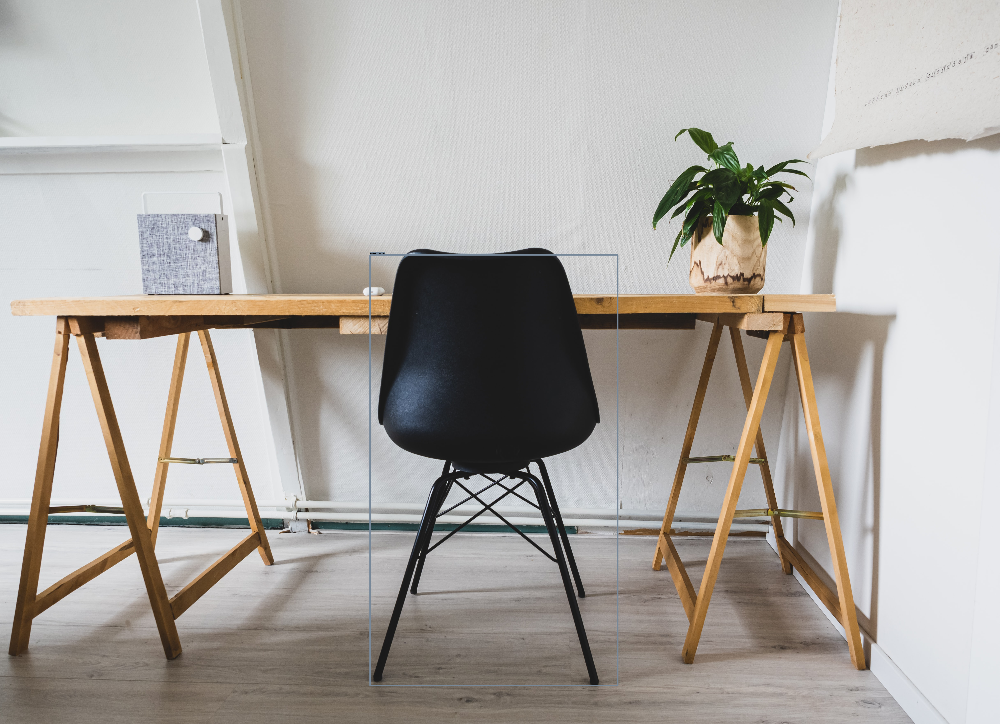

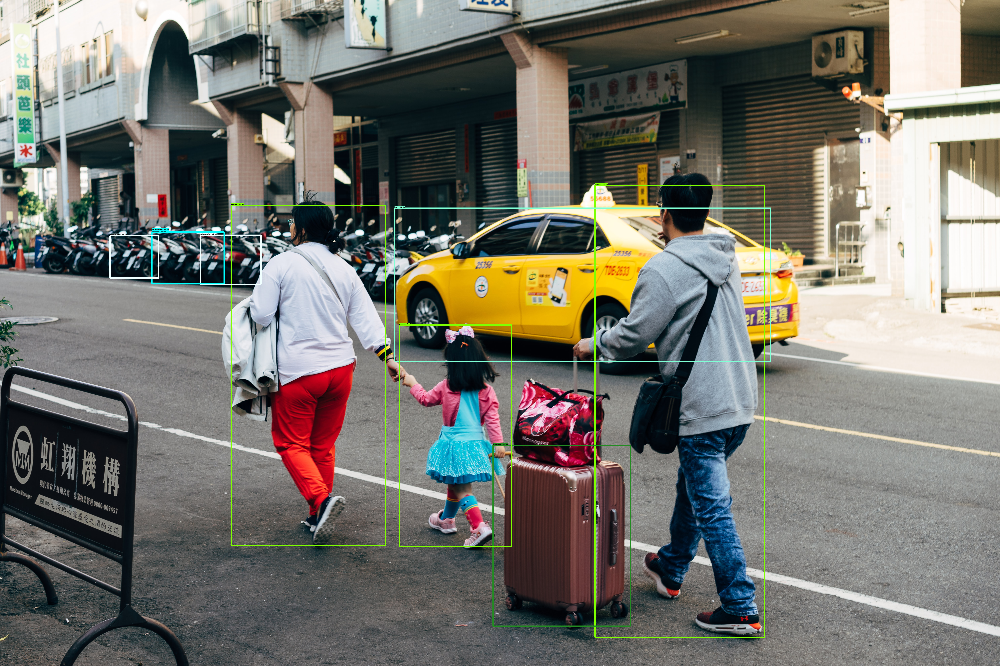

In [33]:
for image_path in TEST_IMAGE_PATHS:
    show_inference(det_model, image_path)